In [1]:
import tensorflow as tf

In [2]:
print(tf.__version__)
tf.config.list_physical_devices('GPU')

2.4.0


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [3]:
#GPU 사용 설정

gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
  # Restrict TensorFlow to only allocate 1GB of memory on the first GPU
  try:
    tf.config.experimental.set_virtual_device_configuration(
        gpus[0],
        [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=1024)])
    logical_gpus = tf.config.experimental.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
  except RuntimeError as e:
    # Virtual devices must be set before GPUs have been initialized
    print(e)

1 Physical GPUs, 1 Logical GPUs


In [4]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 34213009187943748
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 1073741824
locality {
  bus_id: 1
  links {
  }
}
incarnation: 12853752432390804978
physical_device_desc: "device: 0, name: NVIDIA GeForce GTX 1050, pci bus id: 0000:01:00.0, compute capability: 6.1"
]


<h1> Load Image </h1>

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import keras
from keras.preprocessing.image import load_img
import random
import os, sys
from keras.preprocessing import image
from PIL import Image

In [6]:
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array
from numpy import expand_dims

In [7]:
# 이미지 크기 지정

IMAGE_WIDTH = 90
IMAGE_HEIGHT = 90
IMAGE_CHANNEL = 3

In [8]:
datagen = ImageDataGenerator(
            rotation_range = 40,
            width_shift_range = 0.1,
            height_shift_range = 0.1)

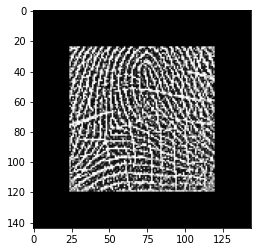

In [9]:
#이미지 로드 확인
image = load_img('./Finger_Training/1 (3).bmp')
plt.imshow(image)

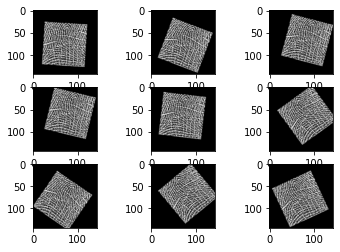

In [10]:
new_image = img_to_array(image)
samples = expand_dims(new_image, 0)

it= datagen.flow(samples, batch_size=1)

for i in range(9):
    batch = it.next()
    image = batch[0].astype('uint8')
    plt.subplot(3, 3, i+1)
    np_image = np.array(image)
    plt.imshow(image)

In [11]:
files = os.listdir('./Finger_Training')

data= []
label= []

# 이미지를 8개의 카테고리로 분류
nb_classes = 8

fig = plt.figure(figsize = (30, 30))
for filename in files:
    category = filename.split(" ")[0]
    image = Image.open('./Finger_Training/'+filename).convert('L')
    image = image.resize((IMAGE_WIDTH, IMAGE_HEIGHT))

    new_image = img_to_array(image)
    samples = expand_dims(new_image, 0)
    #setting an array from which the algorith will randomly choose

    it= datagen.flow(samples, batch_size=1)

    for i in range(30):
        batch = it.next()
        image = batch[0].astype('uint8')
        np_image = np.array(image)
        data.append(np_image)

        #각 이미지 별로 카테고리 분류
        label.append(int(category)-1)
        
    print(data)

[array([[[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       ...,

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]]], dtype=uint8), array([[[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       ...,

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([[[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       ...,

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]]], dtype=uint8), array([[[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       ...,

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([[[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       ...,

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]]], dtype=uint8), array([[[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       ...,

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([[[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       ...,

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]]], dtype=uint8), array([[[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       ...,

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([[[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       ...,

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]]], dtype=uint8), array([[[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       ...,

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([[[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       ...,

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]]], dtype=uint8), array([[[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       ...,

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([[[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       ...,

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]]], dtype=uint8), array([[[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       ...,

       [[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]],

       [[0],
        [0],
   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [12]:
print(label)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

In [13]:
# 훈련데이터셋 형성
train_data = [data, label]
(X, Y) = (train_data[0], train_data[1])

In [14]:
X = np.array(X)
Y = np.array(Y)

In [15]:
print(X.shape)
print(Y.shape)

(2400, 90, 90, 1)
(2400,)


<h1> Build Model </h1>

In [16]:
from keras import Sequential
from keras.layers import Dropout, Activation, Dense
from keras.layers import Flatten, Convolution2D, MaxPooling2D
from keras.models import load_model

In [17]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold
from keras import models, layers, optimizers, utils

In [18]:
# 모델 형성

def build_model():

    learning_rate = 0.0001
    model = Sequential()
    model.add(Convolution2D(filters = 16, kernel_size = (3, 3), padding='same', activation='relu', input_shape = (IMAGE_WIDTH, IMAGE_HEIGHT, 1)))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
  
    model.add(Convolution2D(filters = 64, kernel_size = (3, 3),  activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
     
    model.add(Convolution2D(filters = 64, kernel_size = (3, 3)))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
      
    model.add(Flatten())
    model.add(Dense(256, activation = 'relu'))
    model.add(Dropout(0.5))
    model.add(Dense(8, activation = 'softmax'))
  
    model.compile(loss='categorical_crossentropy', optimizer=tf.keras.optimizers.Adam(lr=learning_rate), metrics=['accuracy'])

    return model

In [19]:
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score

In [20]:
# 이미지 훈련을 10회로 분할해 교차검증 진행
scaler = StandardScaler()
skf = StratifiedKFold(n_splits=10)

In [21]:
model = build_model()
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 90, 90, 16)        160       
_________________________________________________________________
activation (Activation)      (None, 90, 90, 16)        0         
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 45, 45, 16)        0         
_________________________________________________________________
dropout (Dropout)            (None, 45, 45, 16)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 43, 43, 64)        9280      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 21, 21, 64)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 21, 21, 64)        0

In [22]:
# 모델을 사용한 훈련 진행

all_history = []
all_acc = []
all_f1 = []
all_recall = []
all_precision = []

for train_index, test_index in skf.split(X, Y):
    X_train, X_test, Y_train, Y_test = train_test_split(X,
                                                         Y,
                                                         test_size = 0.2,
                                                         random_state=10)

    X_train = np.array(X_train)
    X_test = np.array(X_test)

    X_train = np.reshape(X_train, (len(X_train), IMAGE_WIDTH, IMAGE_HEIGHT, 1))
    X_test = np.reshape(X_test, (len(X_test), IMAGE_WIDTH, IMAGE_HEIGHT, 1))

    X_train = X_train.astype('float32')
    X_test = X_test.astype('float32')
    Y_train = utils.to_categorical(Y_train, nb_classes)
    Y_test = utils.to_categorical(Y_test, nb_classes)
    
    X_train /= 255
    X_test /= 255

    history = model.fit(X_train, Y_train, epochs = 90, batch_size = 32, verbose = 1)
    all_history.append(history.history)

    Y_pred = model.predict(X_test)
    Y_pred_binary = np.around(Y_pred)

    acc = accuracy_score(Y_test, Y_pred_binary)
    f1 = f1_score(Y_test, Y_pred_binary, average = 'micro')
    recall = recall_score(Y_test, Y_pred_binary, average = 'micro')
    precision = precision_score(Y_test, Y_pred_binary, average = 'micro')
    
    all_acc.append(acc)
    all_f1.append(f1)
    all_recall.append(recall)
    all_precision.append(precision)


Epoch 1/90
60/60 [==============================] - 4s 18ms/step - loss: 2.1045 - accuracy: 0.1435
Epoch 2/90
60/60 [==============================] - 1s 18ms/step - loss: 2.0615 - accuracy: 0.1568
Epoch 3/90
60/60 [==============================] - 1s 18ms/step - loss: 2.0513 - accuracy: 0.1754
Epoch 4/90
60/60 [==============================] - 1s 23ms/step - loss: 2.0125 - accuracy: 0.2129
Epoch 5/90
60/60 [==============================] - 2s 29ms/step - loss: 1.9319 - accuracy: 0.2667
Epoch 6/90
60/60 [==============================] - 1s 22ms/step - loss: 1.6112 - accuracy: 0.4774
Epoch 7/90
60/60 [==============================] - 1s 20ms/step - loss: 1.1079 - accuracy: 0.6322
Epoch 8/90
60/60 [==============================] - 1s 22ms/step - loss: 0.8183 - accuracy: 0.7191
Epoch 9/90
60/60 [==============================] - 1s 24ms/step - loss: 0.6264 - accuracy: 0.7967 1s
Epoch 10/90
60/60 [==============================] - 1s 20ms/step - loss: 0.5699 - accuracy: 0.8051
Epoch 

In [23]:
print("Train : ", X_train.shape)
print("Test : ", X_test.shape)

print("Train : ", Y_train.shape)
print("Test : ", Y_test.shape)

Train :  (1920, 90, 90, 1)
Test :  (480, 90, 90, 1)
Train :  (1920, 8)
Test :  (480, 8)


In [24]:
#모델의 average score 출력
print(sum(all_acc)/10)
print(sum(all_f1)/10)
print(sum(all_recall)/10)
print(sum(all_precision)/10)

0.9841666666666666
0.9846538464055568
0.9841666666666666
0.9851444930790689


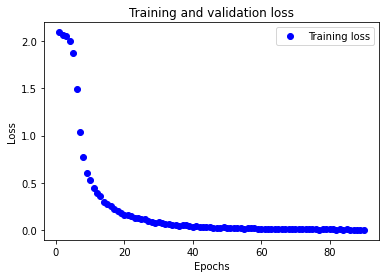

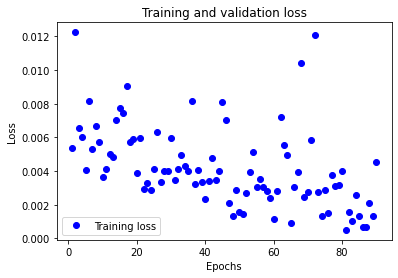

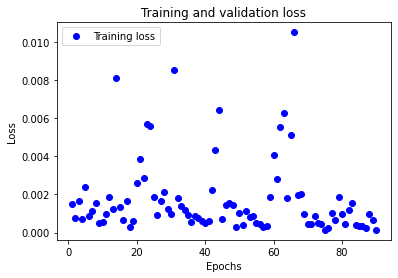

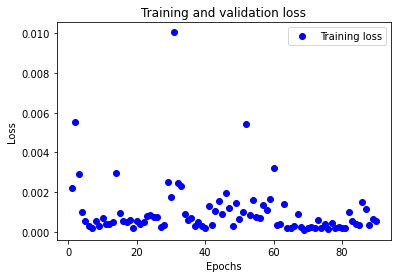

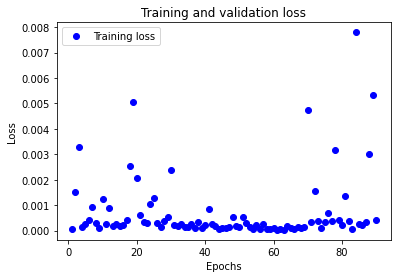

In [25]:
# 훈련 단계 별 Training and validation loss

for i in range(5):
    loss =all_history[i]['loss']
    #val_loss = all_history[i]['val_loss']
    epochs = range(1, len(loss) + 1)
    plt.plot(epochs, loss, 'bo', label='Training loss') 
    plt.title('Training and validation loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

In [26]:
score = model.evaluate(X_test, Y_test, verbose=0)
print('Test score:', score[0])
print('Test accuracy:', score[1])

Test score: 0.0023020494263619184
Test accuracy: 0.9979166388511658


<h1> Test </h1>

In [27]:
# 테스트데이터 파일을 숫자 순으로 정렬
import natsort
order_list = os.listdir('./Finger_Test')
order_list = natsort.natsorted(order_list)

In [28]:
test_data= []

nb_classes = 8

for filename in order_list:
    category = filename.split(".")[0]
    image = Image.open('./Finger_Test/'+filename).convert('L')
    image = image.resize((IMAGE_WIDTH, IMAGE_HEIGHT))
    
    np_image = np.array(image)
    test_data.append(np_image)

    print(filename)

1.bmp
2.bmp
3.bmp
4.bmp
5.bmp
6.bmp
7.bmp
8.bmp
9.bmp
10.bmp
11.bmp
12.bmp
13.bmp
14.bmp
15.bmp
16.bmp
17.bmp
18.bmp
19.bmp
20.bmp
21.bmp
22.bmp
23.bmp
24.bmp
25.bmp
26.bmp
27.bmp
28.bmp
29.bmp
30.bmp
31.bmp
32.bmp
33.bmp
34.bmp
35.bmp
36.bmp
37.bmp
38.bmp
39.bmp
40.bmp
41.bmp
42.bmp
43.bmp
44.bmp
45.bmp
46.bmp
47.bmp
48.bmp
49.bmp
50.bmp
51.bmp
52.bmp
53.bmp
54.bmp
55.bmp
56.bmp
57.bmp
58.bmp
59.bmp
60.bmp
61.bmp
62.bmp
63.bmp
64.bmp
65.bmp
66.bmp
67.bmp
68.bmp
69.bmp
70.bmp
71.bmp
72.bmp
73.bmp
74.bmp
75.bmp
76.bmp
77.bmp
78.bmp
79.bmp
80.bmp


In [29]:
test_data = np.array(test_data)
test_data = np.reshape(test_data, (len(test_data), IMAGE_WIDTH, IMAGE_HEIGHT, 1))
test_data = test_data.astype('float32')

In [30]:
predict = model.predict(test_data)

In [31]:
print(test_data.shape, predict.shape)

(80, 90, 90, 1) (80, 8)


In [32]:
# 예측값 출력
print(predict)

[[0. 0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0.]
 

<h1> Result </h1>

In [33]:
import csv
f = open('result.csv', 'w', newline='')
wr = csv.writer(f)

In [34]:
wr.writerow(['Image', 'Answer'])
for i in range(len(predict)):
    for j in range(len(predict[i])):
        if predict[i][j] == 1:
            wr.writerow([i+1, j+1])

In [35]:
f.close()